In [1]:
import numpy as np
import cv2 
import matplotlib.pyplot as plt
import random 
import plotly.express as px
from skimage import io
from scipy.linalg import rq


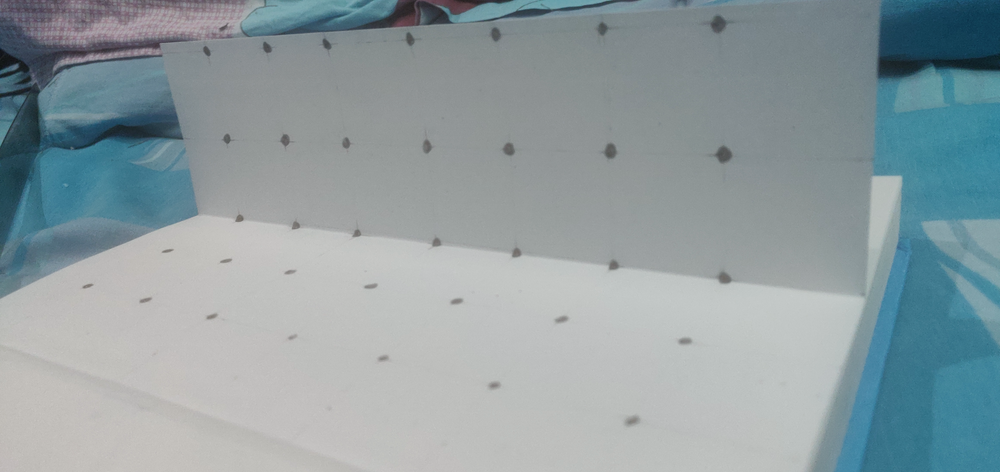

In [2]:
img = cv2.imread('../images/test_img.jpg')

fig = px.imshow(img)
fig.show()

In [116]:

img_2d = np.array([[3328,710] ,[2583,1484] ,[2755,120]  ,[2789,710]  ,[2314,693]  ,[2405,1157] ,[2285,120]  ,[1970,659]  ,[1884,166]  ,[1632,1078] ,[1586,653]  ,[1494,190]  ,[1311,643]  ,[944,230]   ,[3145,1561] ,[2262,1788] ,[2084,1398] ,[1741,1656] ,[1689,1309] ,[1345,1550] ,[1316,1246] ,[944,1464]  ,[1030,1200] ,[686 ,1390] ,[778,1149]] ,dtype ='float32' )

world_3d = np.array([[0,1,0] ,[1,0,1] ,[0,2,1] ,[0,1,1] ,[0,1,2] ,[0,0,2] ,[0,2,2] ,[0,1,3] ,[0,2,3] ,[0,0,4] ,[0,1,4] ,[0,2,4] ,[0,1,5] ,[0,2,6] ,[1,0,0] ,[2,0,1] ,[1,0,2] ,[2,0,2] ,[1,0,3] ,[2,0,3] ,[1,0,4],[2,0,4],[1,0,5],[2,0,5],[1,0,6]] ,dtype='float32')

In [117]:
def proj_matrix(img_pts , world_pts):
    
    idx = [0, 5, 13, 16, 20, 23]
    
    idx1 = random.sample(range(0,14) ,3)
    idx2 = random.sample(range(14, len(img_pts)-1) ,3)
    idx = idx1 + idx2
    idx = sorted(idx)

    points2d = img_pts[idx]
    points3d = world_pts[idx]
    
    proj_M = []
    
    for i in range( len(points2d) ):
        u,v = points2d[i,0] ,points2d[i,1]
        x,y,z = points3d[i,0] ,points3d[i,1] ,points3d[i,2]
        
        
        row1 = [ x ,y ,z ,1 ,0 ,0 ,0 ,0 ,-u*x ,-u*y ,-u*z ,-u]
        row2 = [ 0 ,0 ,0 ,0 ,x ,y ,z ,1 ,-v*x ,-v*y ,-v*z ,-v]
        
        proj_M.append(row1)
        proj_M.append(row2)
    
    proj_M = np.asarray(proj_M)
    
    u,s,vh =  np.linalg.svd(proj_M )
    
    ans = vh[-1,:]/vh[-1,-1]
    ans = ans.reshape(3,4)
    return ans


def reporjection_error( P , points2d ,points3d ):
    n = len(points2d)
    residual = 0
    recon_points = []
    
    for i in range(n):
        temp = points3d[i]
        temp = np.append( temp , 1)
        
        ans = np.dot(P, temp.T)
        ans = ans / ans[2]
        recon_points.append([ans[0] ,ans[1]])
        residual += np.hypot(ans[0]-points2d[i,0] , ans[1]-points2d[i,1] )
        
    return residual/n ,recon_points

In [120]:
p = proj_matrix( img_2d ,world_3d)
residual,new_points = reporjection_error(p,img_2d ,world_3d)

print('Projection Matrix')
print(p)

print()
print('Residual : '+str(residual))

Projection Matrix
[[-5.08714659e+02 -1.01475023e+02 -3.12761889e+02  3.51765006e+03]
 [ 2.60274638e+02 -5.22588418e+02  1.57389430e+01  1.30098617e+03]
 [-3.22018940e-03  3.67679946e-02  7.47364977e-02  1.00000000e+00]]

Residual : 62.92113390991736


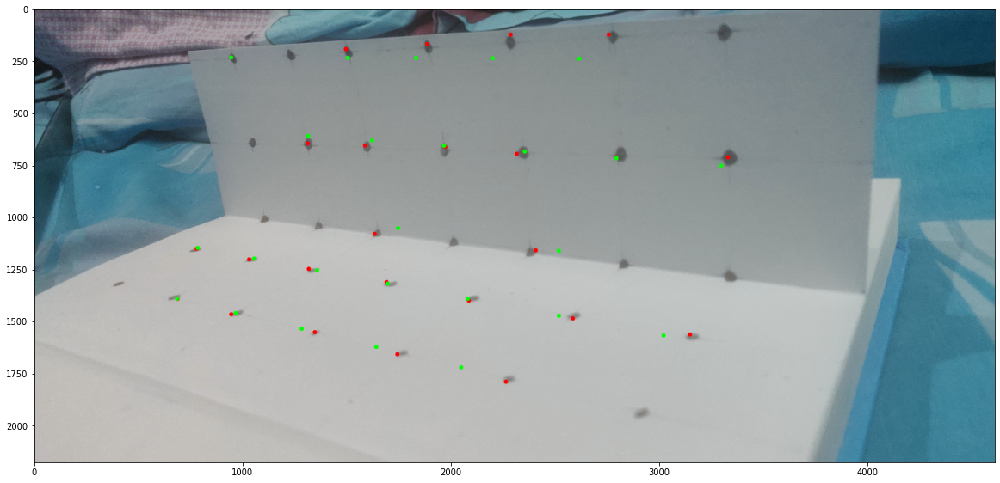

In [121]:
img = cv2.imread('../images/test_img.jpg')

for pts in range(len(new_points)):
    orig_pts = img_2d[pts]
    orig_pts = int(orig_pts[0]) ,int(orig_pts[1])
    proj_ptsx ,proj_ptsy = int(new_points[pts][0]),int(new_points[pts][1])
    
    cv2.circle(img,tuple(orig_pts),10,255,-1)
    cv2.circle(img,tuple([proj_ptsx,proj_ptsy]) ,10,(0, 255, 0) ,-1)
    
plt.figure(figsize=(20,20))
plt.imshow(img)

In [112]:
for i in range(len(img_2d)):
    print(img_2d[i],new_points[i],world_3d[i])

[3328.  710.] [3336.5558888088276, 712.6804995207746] [0. 1. 0.]
[2583. 1484.] [2556.048879351562, 1457.73647694903] [1. 0. 1.]
[2755.  120.] [2785.3588393996215, 71.54480108796834] [0. 2. 1.]
[2789.  710.] [2772.6776650879656, 698.799375053223] [0. 1. 1.]
[2314.  693.] [2306.8331543245536, 687.3315698349927] [0. 1. 2.]
[2405. 1157.] [2333.575647602502, 1167.129979905695] [0. 0. 2.]
[2285.  120.] [2275.133456357857, 118.59384870845713] [0. 2. 2.]
[1970.  659.] [1915.5013432488472, 677.6980614831197] [0. 1. 3.]
[1884.  166.] [1853.4275106437003, 157.48031688741204] [0. 2. 3.]
[1632. 1078.] [1654.0149847815014, 1084.2193905666645] [0. 0. 4.]
[1586.  653.] [1582.1284664546954, 669.4913420138888] [0. 1. 4.]
[1494.  190.] [1499.0437939984595, 190.15884860013745] [0. 2. 4.]
[1311.  643.] [1294.7261302069553, 662.416290284821] [0. 1. 5.]
[944. 230.] [2054.953925292275, -3831.7404689405803] [0. 6. 2.]
[3145. 1561.] [3136.03025600211, 1558.2126563284423] [1. 0. 0.]
[2262. 1788.] [2269.376340122

### Ransac Based Variant 

In [129]:
def proj_matrix(points2d , points3d):
    
    proj_M = []
    
    for i in range( len(points2d) ):
        u,v = points2d[i,0] ,points2d[i,1]
        x,y,z = points3d[i,0] ,points3d[i,1] ,points3d[i,2]
        
        
        row1 = [ x ,y ,z ,1 ,0 ,0 ,0 ,0 ,-u*x ,-u*y ,-u*z ,-u]
        row2 = [ 0 ,0 ,0 ,0 ,x ,y ,z ,1 ,-v*x ,-v*y ,-v*z ,-v]
        
        proj_M.append(row1)
        proj_M.append(row2)
    
    proj_M = np.asarray(proj_M)
    
    u,s,vh =  np.linalg.svd(proj_M )
    
    ans = vh[-1,:]/vh[-1,-1]
    ans = ans.reshape(3,4)
    return ans

def RANSAC(img_2d , world_3d , ite = 30): 
    min_residual = 10000
    P = None
    proj_pts = None
    
    temp = np.concatenate((img_2d , world_3d), axis = 1)
    
    for i  in range(ite):
        np.random.shuffle(temp)
        pts_2d  = temp[:6,[0,1]]
        pts_3d  = temp[:6,[2,3,4]]

        P_temp = proj_matrix( pts_2d , pts_3d)
        
        residual,projected_2d_pts = reporjection_error(P_temp,img_2d ,world_3d)

        if residual < min_residual:
            min_residual = residual
            P = P_temp
            proj_pts = projected_2d_pts
            
    return P ,min_residual ,proj_pts


p , res , proj = RANSAC(img_2d ,world_3d)

print('Projection Matrix P :')
print(p)

print()
print('Residual : ' + str(res) )

Projection Matrix P :
[[-5.94998866e+02 -1.93202458e+02 -2.82157599e+02  3.33447807e+03]
 [ 6.41062894e+01 -6.08020490e+02  3.76421314e+01  1.29625456e+03]
 [-1.28979446e-01 -5.81725980e-02  8.36393124e-02  1.00000000e+00]]

Residual : 19.998628061730358


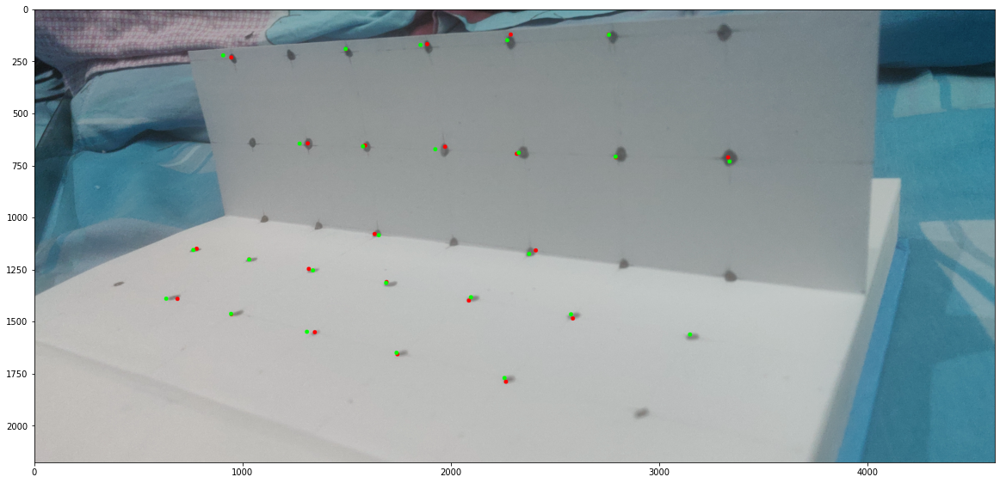

In [130]:
img = cv2.imread('../images/test_img.jpg')

for pts in range(len(proj)):
    orig_pts = img_2d[pts]
    orig_pts = int(orig_pts[0]) ,int(orig_pts[1])
    proj_ptsx ,proj_ptsy = int(proj[pts][0]),int(proj[pts][1])
    
    cv2.circle(img,tuple(orig_pts),10,255,-1)
    cv2.circle(img,tuple([proj_ptsx,proj_ptsy]) ,10,(0, 255, 0) ,-1)
    
plt.figure(figsize=(20,20))
plt.imshow(img)